# Analisis exploratorio de Datos

Notebook basado y modificado del original de [Madhan Chandrasekharan](https://www.kaggle.com/gcmadhan/covid-vaccine-eda-visualization)

## Importación de módulos 

In [1]:
# import numpy as np # linear algebra
import pandas as pd

## Carga de datos 

In [2]:
df = pd.read_csv('data/country_vaccinations.csv')

## Exploración 

In [6]:
df.tail()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
21623,Zimbabwe,ZWE,2021-05-27,953389.0,648121.0,305268.0,16349.0,12285.0,6.41,4.36,2.05,827.0,Sinopharm/Beijing,Ministry of Health,https://twitter.com/MoHCCZim/status/1399441311...
21624,Zimbabwe,ZWE,2021-05-28,976796.0,656630.0,320166.0,23407.0,12695.0,6.57,4.42,2.15,854.0,Sinopharm/Beijing,Ministry of Health,https://twitter.com/MoHCCZim/status/1399441311...
21625,Zimbabwe,ZWE,2021-05-29,1002465.0,666786.0,335679.0,25669.0,14056.0,6.74,4.49,2.26,946.0,Sinopharm/Beijing,Ministry of Health,https://twitter.com/MoHCCZim/status/1399441311...
21626,Zimbabwe,ZWE,2021-05-30,1011973.0,670755.0,341218.0,9508.0,14420.0,6.81,4.51,2.30,970.0,Sinopharm/Beijing,Ministry of Health,https://twitter.com/MoHCCZim/status/1399441311...
21627,Zimbabwe,ZWE,2021-05-31,1020078.0,675678.0,344400.0,8105.0,15022.0,6.86,4.55,2.32,1011.0,Sinopharm/Beijing,Ministry of Health,https://twitter.com/MoHCCZim/status/1399441311...


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21628 entries, 0 to 21627
Data columns (total 15 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   country                              21628 non-null  object        
 1   iso_code                             21628 non-null  object        
 2   date                                 21628 non-null  datetime64[ns]
 3   total_vaccinations                   12275 non-null  float64       
 4   people_vaccinated                    11479 non-null  float64       
 5   people_fully_vaccinated              8967 non-null   float64       
 6   daily_vaccinations_raw               10187 non-null  float64       
 7   daily_vaccinations                   21412 non-null  float64       
 8   total_vaccinations_per_hundred       12275 non-null  float64       
 9   people_vaccinated_per_hundred        11479 non-null  float64       
 10  people_ful

In [ ]:
# df.rename(columns = {'source_name': 'fuente', 
#                            'source_website': 'fuente - sitio web'
#                     }, 
#                 inplace = True)

In [8]:
# El campo 'date' se cargó como type:object, y lo convertimos a type:date, para poder trabajarlo como una fecha.
df['date']=pd.to_datetime(df['date'])

In [10]:
type(df['date'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [11]:
# Listamos las variables y los valores nulos de cada uno.
df.isna().sum()

country                                    0
iso_code                                   0
date                                       0
total_vaccinations                      9353
people_vaccinated                      10149
people_fully_vaccinated                12661
daily_vaccinations_raw                 11441
daily_vaccinations                       216
total_vaccinations_per_hundred          9353
people_vaccinated_per_hundred          10149
people_fully_vaccinated_per_hundred    12661
daily_vaccinations_per_million           216
vaccines                                   0
source_name                                0
source_website                             0
dtype: int64

In [12]:
# "Forma" del dataframe
df.shape

(21628, 15)

In [14]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [15]:
# Listado de paises y registros
df['country'].value_counts()

Norway                              180
Scotland                            172
Canada                              169
China                               168
Russia                              168
Denmark                             165
Israel                              164
United States                       162
Qatar                               161
Bahrain                             160
Mexico                              159
Chile                               158
Liechtenstein                       156
Portugal                            156
Czechia                             156
Estonia                             156
Italy                               156
Slovenia                            156
Lithuania                           156
Austria                             156
Belgium                             155
France                              155
Latvia                              155
Greece                              155
Romania                             155


In [16]:
# La variable 'country' no tiene valores nulos
df['country'].isna().sum()

0

In [17]:
#Listado por vacunas y registros
df['vaccines'].value_counts()

Oxford/AstraZeneca                                                                    3774
Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                         3036
Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                                          1687
Oxford/AstraZeneca, Pfizer/BioNTech                                                   1620
Moderna, Pfizer/BioNTech                                                              1276
Pfizer/BioNTech                                                                       1240
Oxford/AstraZeneca, Sinopharm/Beijing                                                 1086
Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac                                          1054
Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sputnik V                      927
Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing                                 416
Oxford/AstraZeneca, Sinopharm/Beijing, Sputnik V                                       404

In [18]:
df.groupby(['vaccines','country']).count()

iso_code  \
vaccines                                           country                                      
Abdala, Soberana02                                 Cuba                                    17   
CanSino, Oxford/AstraZeneca, Pfizer/BioNTech, S... Mexico                                 159   
CanSino, Oxford/AstraZeneca, Sinopharm/Beijing,... Pakistan                               115   
CanSino, Sinopharm/Beijing, Sinopharm/Wuhan, Si... China                                  168   
Covaxin, Oxford/AstraZeneca                        Central African Republic                20   
                                                   India                                  137   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing     Comoros                                 36   
                                                   Mauritius                              127   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing,... Paraguay                                99   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing,... Iran                                   106   
EpiVacCorona, Oxford/AstraZeneca, Sinopharm/Bei... Turkmenistan                             1   
EpiVacCorona, Sputnik V                            Russia                                 168   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, P... Austria                                156   
                                                   Belgium                                155   
                                                   Bulgaria                               154   
                                                   Cyprus                                 145   
                                                   Czechia                                156   
                                                   Estonia                                156   
                                                   France                                 155   
                                                   Germany                                155   
                                                   Greece                                 155   
                                                   Iceland                                150   
                                                   Ireland                                144   
                                                   Italy                                  156   
                                                   Latvia                                 155   
                                                   Lithuania                              156   
                                                   Malta                                  134   
                                                   Netherlands                            141   
                                                   Poland                                 155   
                                                   Portugal                               156   
                                                   Romania                                155   
                                                   Spain                                  147   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, P... Libya                                   24   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, S... Honduras                                90   
Johnson&Johnson, Moderna, Pfizer/BioNTech          United States                          162   
Johnson&Johnson, Pfizer/BioNTech                   South Africa                           105   
Moderna, Oxford/AstraZeneca                        Guatemala                               95   
Moderna, Oxford/AstraZeneca, Pfizer/BioNTech       Canada                                 169   
                                                   Croatia                                152   
                                                   England                                153   
           

In [ ]:
df.info()

In [21]:
df.groupby(['vaccines','country']).agg(
    **{
        'Cantidad Registros': ('iso_code', 'count'),
        'Vacunados promedio por fecha': ('daily_vaccinations', 'mean')
    })

Cantidad Registros  \
vaccines                                           country                                                
Abdala, Soberana02                                 Cuba                                              17   
CanSino, Oxford/AstraZeneca, Pfizer/BioNTech, S... Mexico                                           159   
CanSino, Oxford/AstraZeneca, Sinopharm/Beijing,... Pakistan                                         115   
CanSino, Sinopharm/Beijing, Sinopharm/Wuhan, Si... China                                            168   
Covaxin, Oxford/AstraZeneca                        Central African Republic                          20   
                                                   India                                            137   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing     Comoros                                           36   
                                                   Mauritius                                        127   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing,... Paraguay                                          99   
Covaxin, Oxford/AstraZeneca, Sinopharm/Beijing,... Iran                                             106   
EpiVacCorona, Oxford/AstraZeneca, Sinopharm/Bei... Turkmenistan                                       1   
EpiVacCorona, Sputnik V                            Russia                                           168   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, P... Austria                                          156   
                                                   Belgium                                          155   
                                                   Bulgaria                                         154   
                                                   Cyprus                                           145   
                                                   Czechia                                          156   
                                                   Estonia                                          156   
                                                   France                                           155   
                                                   Germany                                          155   
                                                   Greece                                           155   
                                                   Iceland                                          150   
                                                   Ireland                                          144   
                                                   Italy                                            156   
                                                   Latvia                                           155   
                                                   Lithuania                                        156   
                                                   Malta                                            134   
                                                   Netherlands                                      141   
                                                   Poland                                           155   
                                                   Portugal                                         156   
                                                   Romania                                          155   
                                                   Spain                                            147   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, P... Libya                                             24   
Johnson&Johnson, Moderna, Oxford/AstraZeneca, S... Honduras                                          90   
Johnson&Johnson, Moderna, Pfizer/BioNTech          United States                                    162   
Johnson&Johnson, Pfizer/BioNTech                   South Africa                                     105   
Moderna, Oxford/Ast

In [20]:
# Corregimos el formato de los números
pd.options.display.float_format = '{:,.2f}'.format

## Análisis gráfico

In [24]:
# Importamos los paquetes para poder graficas
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
df.columns

###  Grafico I. Personas con el proceso de vacunación finalizado por país

In [22]:
data1=df.groupby(by=['country']).sum().reset_index()

In [28]:
fig = px.bar(data1.sort_values(by=['people_vaccinated'],
                         ascending=False).reset_index(),
       x='country',
       y='people_vaccinated',
       title='Personas con el proceso de vacunación finalizado por país',
       color='country')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [26]:
data1.head()

,country,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,"3,831,799.00","3,256,958.00","574,841.00","2,859.00","594,456.00",9.85,8.36,1.48,"15,285.00"
1,Albania,"24,787,760.00","6,990,919.00","3,550,624.00","552,252.00","760,906.00",861.34,242.91,123.37,"264,395.00"
2,Algeria,"75,030.00",0.00,0.00,30.00,"69,070.00",0.17,0.00,0.00,"1,568.00"
3,Andorra,"249,370.00","156,305.00","31,652.00","4,802.00","31,649.00",322.74,202.31,40.98,"409,618.00"
4,Angola,"5,386,560.00","4,717,488.00","669,072.00",0.00,"880,797.00",16.39,14.35,2.04,"26,808.00"


### Gráfico II - Vacunas por laboratorio

In [ ]:
data2=df.groupby(by=['vaccines','country']).sum().reset_index()

In [ ]:
data2

In [ ]:
fig = go.Figure()
fig= px.bar(data2.sort_values(by=['people_fully_vaccinated_per_hundred'],
                         ascending=False).reset_index(),
       x='vaccines',
       y='people_fully_vaccinated_per_hundred',
       title='Vacunas por laboratorio',
       color='vaccines',
       hover_name='country')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico III - Evolución de las personas vacunadas por país 

In [ ]:
df.head()

In [ ]:
fig = px.line(df,
        y='people_vaccinated',
        x=df['date'],
#         color='country',
        title='Personas vacunadas por país')

fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [ ]:
fig = px.line(df,
        y='people_fully_vaccinated',
        x=df['date'],
        color='country',
        title='Personas con dosis completas por país')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [ ]:
df.head()

In [ ]:
data = df[[
    'country', 'total_vaccinations', 'people_vaccinated',
    'people_fully_vaccinated', 'vaccines', 'iso_code'
]].groupby(by=['country', 'iso_code', 'vaccines']).sum().reset_index()

In [ ]:
data

### Grafico IV - Total de dosis y personas vacunadas, por país.

In [ ]:
fig = px.scatter(data,
           x='total_vaccinations',
           y='people_vaccinated',
           color='country',
           size='people_vaccinated',
           title='Total de dosis y personas vacunadas, por país')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico V - Personas vacunadas por país

In [ ]:
fig = px.scatter_geo(data,
               locations='iso_code',
               size='people_vaccinated',
               color='vaccines',
               title='Personas vacunadas por país')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico VI - Personas con el proceso de vacunación completo por país, por vacuna

In [ ]:
fig = px.scatter_geo(data,
               locations='iso_code',
               size='people_fully_vaccinated',
               color='vaccines',
               title='Personas con el proceso de vacunación completo por país, por vacuna')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

## Modulos EDA

###  Pandas Profiling

In [29]:
# Importamos el módulo
from pandas_profiling import ProfileReport

In [30]:
# Generamos el reporte
profile = ProfileReport(df, title="COVID Vaccines")

In [31]:
# Mostramos el reporte
profile.to_widgets()

### Sweetviz 

In [35]:
# Importamos el módulo
!pip install sweetviz
import sweetviz as sv

Defaulting to user installation because normal site-packages is not writeable


In [33]:
# Generamos el reporte
my_report = sv.analyze(df)


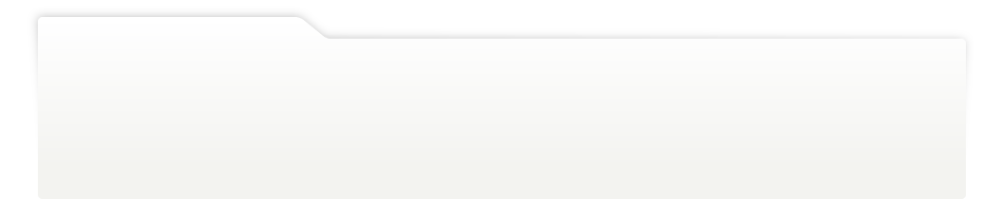
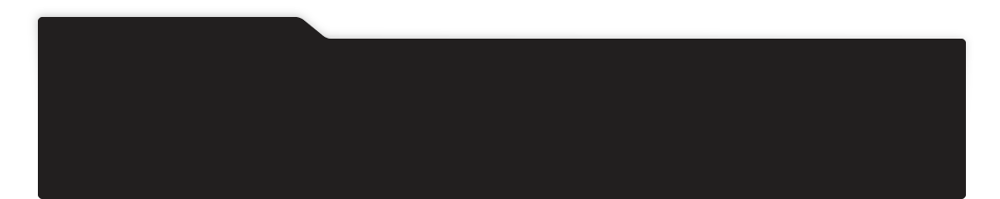
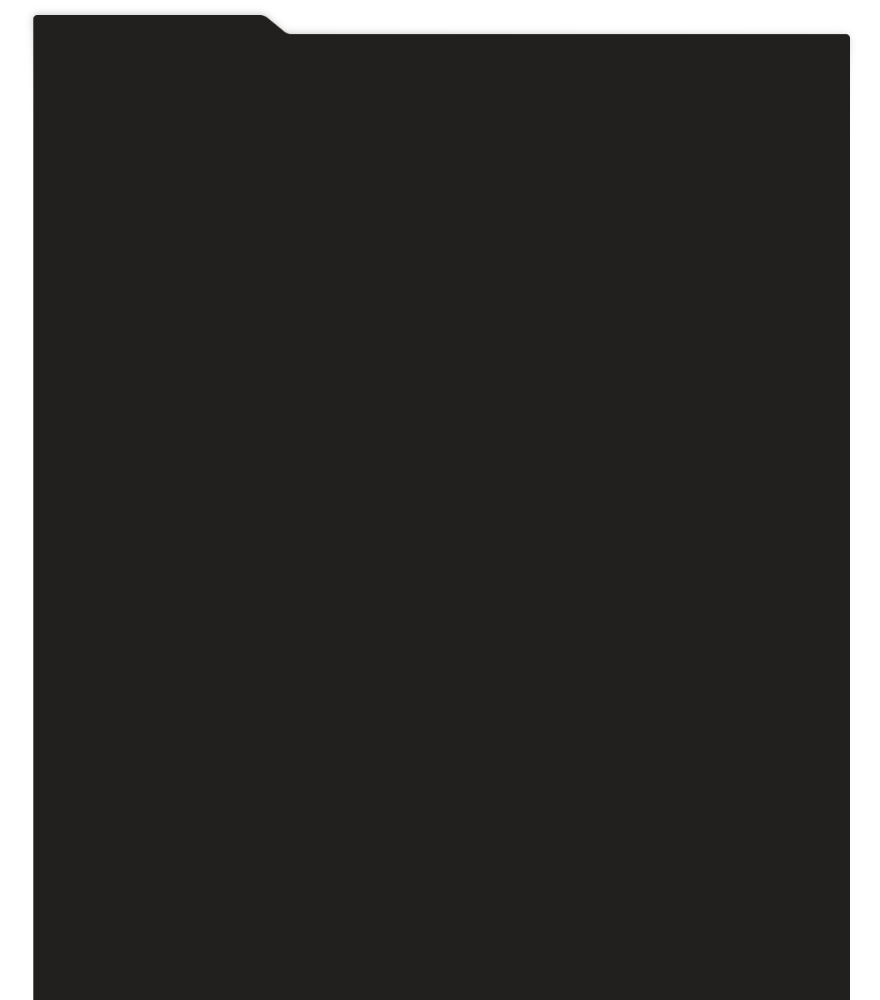
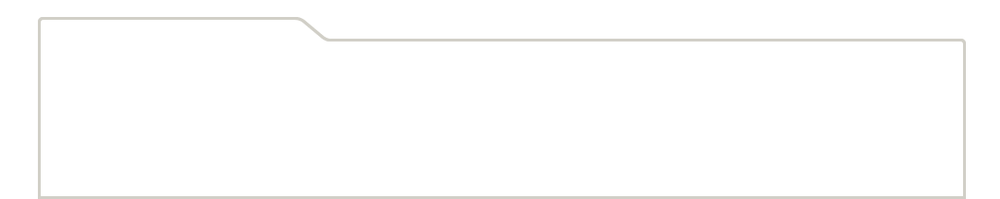
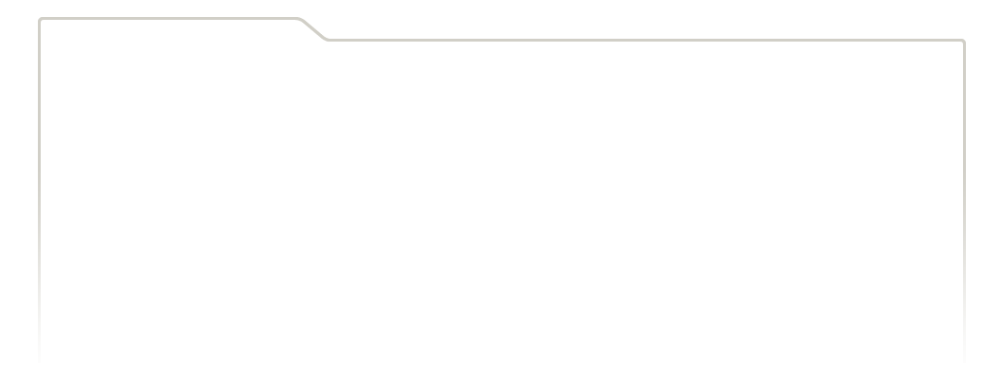
...
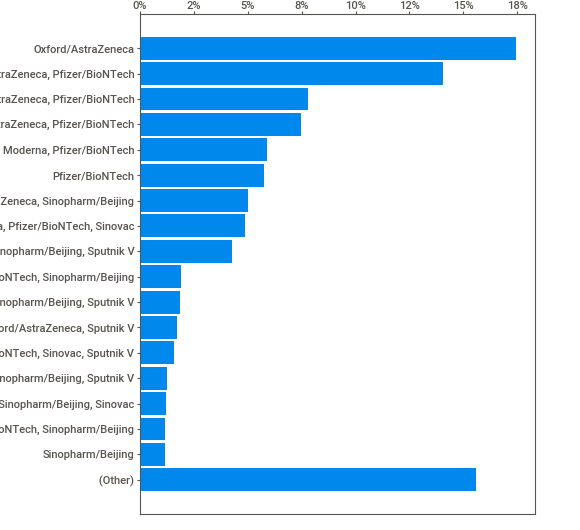
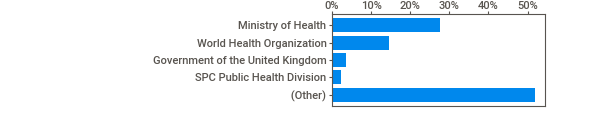
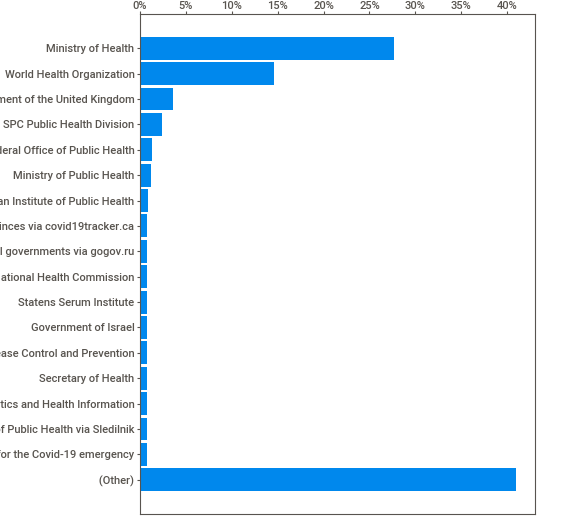
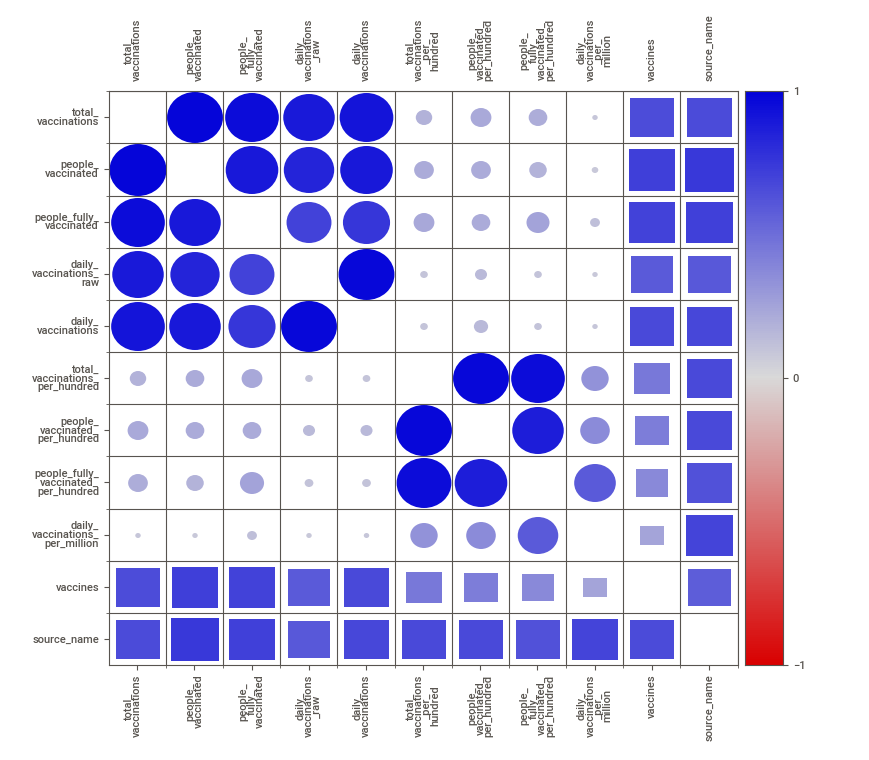
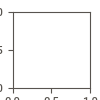

In [34]:
# El reporte se puede exportar a HTML o previsualizarlo en el notebook:

# my_report.show_html()                # Exporta a HTML
my_report.show_notebook()              # Previasualiza en el notebook

# Exportación 

In [ ]:
%%javascript
IPython.notebook.kernel.execute('nb_name = "' + IPython.notebook.notebook_name + '"')

In [ ]:
!jupyter nbconvert --TagRemovePreprocessor.enabled=True --to html $nb_name 

In [ ]:
!jupyter nbconvert --TagRemovePreprocessor.enabled=True --TagRemovePreprocessor.remove_cell_tags='{"no"}' --no-input --to html $nb_name 